In [2]:
import pandas as pd
import numpy as np
import os

In [4]:
bed_files_root = '/data1/tmp/bed_intersects/'
bed_files = os.listdir(bed_files_root)

In [5]:
apa_atlas = pd.read_csv('/data1/APA/Paul_ALS_Data/bams_in/subscelltype_bamfiles/human_PAS_hg38.bed', sep='\t')
apa_atlas.columns = ['chr', 'start', 'end', 'gene', 'type', 'strand', 'PAs', 'gene_type']
apa_atlas.head()

,chr,start,end,gene,type,strand,PAs,gene_type
0,chr1,629229,629269,MTND1P23,Single exon,+,chr1:629249:+,Pseudogene
1,chr1,629264,629304,MTND1P23,Single exon,+,chr1:629284:+,Pseudogene
2,chr1,629308,629348,MTND1P23,Single exon,+,chr1:629328:+,Pseudogene
3,chr1,629552,629592,MTND1P23,Single exon,+,chr1:629572:+,Pseudogene
4,chr1,629606,629646,MTND1P23,Single exon,+,chr1:629626:+,Pseudogene


In [6]:
ref_dict = { k:0 for k in apa_atlas['gene'] + ':' + apa_atlas['PAs']}

In [7]:
# lets read in the bed files and count the number of times each PAS is found in each bed file:
count_dict = {}
for bed_file in bed_files:
    tmp_bed = pd.read_csv(bed_files_root + bed_file, sep='\t', header=None)
    tmp_bed.columns = ['chr', 'start', 'end', 'gene', 'type', 'strand', 'PAs', 'gene_type']
    tmp_bed['gene_PAs'] = tmp_bed['gene'] + ':' + tmp_bed['PAs']
    gene_name = bed_file.split('.')[0]
    tmp_bed_gene_PAs_cnt = tmp_bed['gene_PAs'].value_counts().to_dict()
    # update teh ref_dict: with the counts for each gene:
    count_dict[gene_name] = ref_dict.copy()
    count_dict[gene_name].update(tmp_bed_gene_PAs_cnt)
count_dict

{'BCL2L1': {'MTND1P23:chr1:629249:+': 0,
  'MTND1P23:chr1:629284:+': 0,
  'MTND1P23:chr1:629328:+': 2,
  'MTND1P23:chr1:629572:+': 1,
  'MTND1P23:chr1:629626:+': 0,
  'MTND2P28:chr1:629907:+': 0,
  'MTND2P28:chr1:630001:+': 0,
  'MTND2P28:chr1:630026:+': 0,
  'MTND2P28:chr1:630267:+': 0,
  'MTND2P28:chr1:630318:+': 0,
  'MTND2P28:chr1:630343:+': 0,
  'MTND2P28:chr1:630369:+': 0,
  'MTND2P28:chr1:630532:+': 0,
  'MTND2P28:chr1:630641:+': 0,
  'MTND2P28:chr1:630686:+': 0,
  'MTND2P28:chr1:630721:+': 0,
  'MTND2P28:chr1:631070:+': 3,
  'MTCO1P12:chr1:631193:+': 0,
  'MTCO1P12:chr1:631399:+': 0,
  'MTCO1P12:chr1:631433:+': 0,
  'MTCO1P12:chr1:631548:+': 0,
  'MTCO1P12:chr1:631579:+': 0,
  'MTCO1P12:chr1:631704:+': 0,
  'MTCO1P12:chr1:631812:+': 0,
  'MTCO1P12:chr1:631869:+': 0,
  'MTCO1P12:chr1:631917:+': 0,
  'MTCO1P12:chr1:631963:+': 0,
  'MTCO1P12:chr1:632107:+': 0,
  'MTCO1P12:chr1:632168:+': 0,
  'MTCO1P12:chr1:632210:+': 0,
  'MTCO1P12:chr1:632247:+': 0,
  'MTCO1P12:chr1:632326:+': 0

In [8]:
apa_cnt = pd.DataFrame.from_dict(count_dict)
apa_cnt.head()

,BCL2L1,ZNF526,DMC1,PLEKHH3,FTSJ3,APBA3,HNRNPA0,BCL2L12,NUDCD2,SDF4,...,TRAF7,UBA52,SEPHS2,ANP32E,ZNF541,GOLGA2,TTC9C,MPG,SNRNP35,SHARPIN
MTND1P23:chr1:629249:+,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,0.0,0.0
MTND1P23:chr1:629284:+,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,0.0,0.0
MTND1P23:chr1:629328:+,2.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,2.0,1,0.0,0.0,0.0
MTND1P23:chr1:629572:+,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,2.0,0,1.0,0.0,0.0
MTND1P23:chr1:629626:+,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0


In [9]:
apa_cnt.shape

(198233, 9327)

In [10]:
apa_cnt.to_csv('/data1/tmp/apa_atlas_counts_2.tsv', sep='\t')

In [11]:
# lets add a mean and median columns to the apa_cnt
apa_cnt['mean'] = np.mean(apa_cnt, axis=1)

In [12]:
apa_cnt['median'] = np.median(apa_cnt, axis=1)

/home/aiden/anaconda3/envs/for_DL/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='mean', ylabel='Density'>

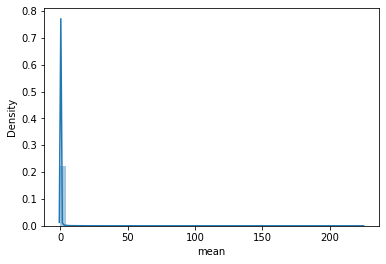

In [13]:
# lets plot the distribution of the mean and median counts:
import seaborn as sns

sns.distplot(apa_cnt['mean'])